In [ ]:
import torch
import torchvision

print(torch.__version__)
print(torchvision.__version__)

2.8.0+cu126
0.23.0+cu126


In [ ]:
# Continue with regular imports
import matplotlib.pyplot as plt
import torch
import torchvision

from torch import nn
from torchvision import transforms

# Try to get torchinfo, install it if it doesn't work
try:
    from torchinfo import summary
except:
    print("[INFO] Couldn't find torchinfo... installing it.")
    !pip install -q torchinfo
    from torchinfo import summary

# Try to import the going_modular directory, download it from GitHub if it doesn't work
try:
    from going_modular.going_modular import data_setup, engine
except:
    # Get the going_modular scripts
    print("[INFO] Couldn't find going_modular scripts... downloading them from GitHub.")
    !git clone https://github.com/mrdbourke/pytorch-deep-learning
    !mv pytorch-deep-learning/going_modular .
    !rm -rf pytorch-deep-learning
    from going_modular.going_modular import data_setup, engine

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

In [ ]:
!nvidia-smi

Sun Oct  5 23:07:53 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   66C    P8             11W /   70W |       2MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [ ]:
import os
import zipfile

from pathlib import Path

import requests

# Setup path to data folder
data_path = Path("data/")
image_path = data_path / "pizza_steak_sushi"

# If the image folder doesn't exist, download it and prepare it...
if image_path.is_dir():
    print(f"{image_path} directory exists.")
else:
    print(f"Did not find {image_path} directory, creating one...")
    image_path.mkdir(parents=True, exist_ok=True)

    # Download pizza, steak, sushi data
    with open(data_path / "pizza_steak_sushi.zip", "wb") as f:
        request = requests.get("https://github.com/mrdbourke/pytorch-deep-learning/raw/main/data/pizza_steak_sushi.zip")
        print("Downloading pizza, steak, sushi data...")
        f.write(request.content)

    # Unzip pizza, steak, sushi data
    with zipfile.ZipFile(data_path / "pizza_steak_sushi.zip", "r") as zip_ref:
        print("Unzipping pizza, steak, sushi data...")
        zip_ref.extractall(image_path)

    # Remove .zip file
    os.remove(data_path / "pizza_steak_sushi.zip")

data/pizza_steak_sushi directory exists.


In [ ]:
train_dir = image_path / "train"
test_dir = image_path  / "test"

In [ ]:
from torchvision import transforms
manual_transform = transforms.Compose([
    transforms.Resize((224,224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 00.225])
])

In [ ]:
train_dataloader, test_dataloader, class_names = data_setup.create_dataloaders(train_dir, test_dir, manual_transform, 32)

In [ ]:
train_dataloader, test_dataloader, class_names

(<torch.utils.data.dataloader.DataLoader at 0x7989b6b17d40>,
 ['pizza', 'steak', 'sushi'])

In [ ]:
from torchvision import models
weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT

In [ ]:
auto_transform = weights.transforms()
auto_transform

ImageClassification(
    crop_size=[224]
    resize_size=[256]
    mean=[0.485, 0.456, 0.406]
    std=[0.229, 0.224, 0.225]
    interpolation=InterpolationMode.BICUBIC
)

In [ ]:
train_dataloader, test_dataloader, class_names = data_setup.create_dataloaders(train_dir, test_dir, auto_transform, 32)
train_dataloader, test_dataloader, class_names

(<torch.utils.data.dataloader.DataLoader at 0x7989b4b84b60>,
 ['pizza', 'steak', 'sushi'])

In [ ]:
model = torchvision.models.efficientnet_b0(weights=weights).to(device)
model

EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
            (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
          )
          (2): Conv2dNormActivat

In [ ]:
model.features

Sequential(
  (0): Conv2dNormActivation(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): SiLU(inplace=True)
  )
  (1): Sequential(
    (0): MBConv(
      (block): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
          (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): SiLU(inplace=True)
        )
        (1): SqueezeExcitation(
          (avgpool): AdaptiveAvgPool2d(output_size=1)
          (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
          (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
          (activation): SiLU(inplace=True)
          (scale_activation): Sigmoid()
        )
        (2): Conv2dNormActivation(
          (0): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), 

In [ ]:
for param in model.features.parameters():
  param.requires_grad = False


In [ ]:
model.classifier = nn.Sequential(
    nn.Dropout(p=0.2, inplace=True),
    nn.Linear(in_features=1280, out_features=len(class_names), )
).to(device)

In [ ]:
from torch import nn
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr= 0.001)

In [ ]:
from going_modular.going_modular import engine

In [ ]:
from timeit import default_timer as timer
start_time = timer()

results = engine.train(model=model,
                       train_dataloader=train_dataloader,
                       test_dataloader=test_dataloader,
                       optimizer=optimizer,
                       loss_fn=loss_fn,
                       epochs=10,
                       device=device)

end_time = timer()

print(f"Total training time : {end_time - start_time}")

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 1.1154 | train_acc: 0.3438 | test_loss: 0.8752 | test_acc: 0.7623
Epoch: 2 | train_loss: 0.8994 | train_acc: 0.6641 | test_loss: 0.7568 | test_acc: 0.8551
Epoch: 3 | train_loss: 0.8044 | train_acc: 0.7500 | test_loss: 0.7528 | test_acc: 0.8040
Epoch: 4 | train_loss: 0.6950 | train_acc: 0.7734 | test_loss: 0.6328 | test_acc: 0.9062
Epoch: 5 | train_loss: 0.6506 | train_acc: 0.7617 | test_loss: 0.6129 | test_acc: 0.8352
Epoch: 6 | train_loss: 0.6242 | train_acc: 0.7852 | test_loss: 0.6192 | test_acc: 0.7841
Epoch: 7 | train_loss: 0.5294 | train_acc: 0.9219 | test_loss: 0.5356 | test_acc: 0.8864
Epoch: 8 | train_loss: 0.5630 | train_acc: 0.7812 | test_loss: 0.4878 | test_acc: 0.8854
Epoch: 9 | train_loss: 0.5266 | train_acc: 0.7773 | test_loss: 0.5094 | test_acc: 0.8352
Epoch: 10 | train_loss: 0.4621 | train_acc: 0.8086 | test_loss: 0.5375 | test_acc: 0.8456
Total training time : 30.380943694000052


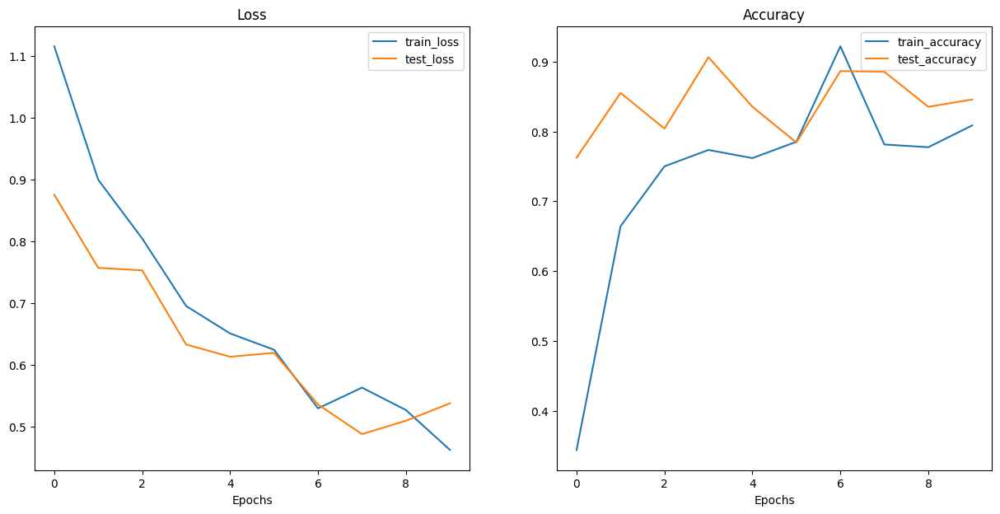

In [ ]:
try:
  from helper_function import plot_loss_curves
except:
  print("Failed couldnt find helper_function.py, downloading")
  with open("helper_function.py", "wb") as f:
    request = requests.get("https://raw.githubusercontent.com/mrdbourke/pytorch-deep-learning/refs/heads/main/helper_functions.py")
    f.write(request.content)
  from helper_function import plot_loss_curves

plot_loss_curves(results)

In [ ]:
from typing import List, Tuple
from PIL import Image
def pred_and_plot_image (model:torch.nn.Module,
                image_path:str,
                class_names : List[str],
                image_size: Tuple[int, int] = (224, 224),
                transform: torchvision.transforms = None,
                device: torch.device = None):

  img = Image.open(image_path)

  if transform is not None:
    image_transform = transform
  else:
    image_transform = transforms.Compose([
        transforms.Resize(image_size),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                          std=[0.229, 0.224, 00.225])
    ])


  model.to(device)

  model.eval()
  with torch.inference_mode():
    transformed_image = image_transform(img).unsqueeze(dim=0)

    target_image_pred = model(transformed_image.to(device))

    target_image_pred_probs = torch.softmax(target_image_pred, dim=1)

    target_image_pred_labels = torch.argmax(target_image_pred_probs, dim=1)

    pred_target = target_image_pred_labels
    pred_class = class_names[target_image_pred_labels]
    pred_prob = target_image_pred_probs.max()
    plt.figure()
    plt.imshow(img)
    plt.title(f"Pred : {pred_class} | Prob: {pred_prob}")
    plt.axis(False)

  return pred_class, pred_prob, pred_target



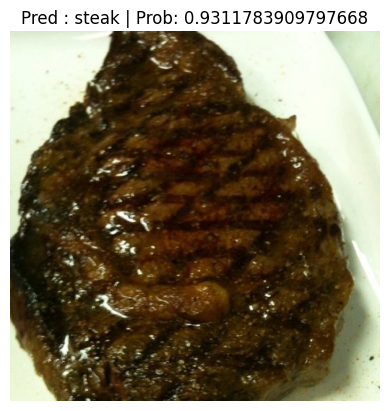

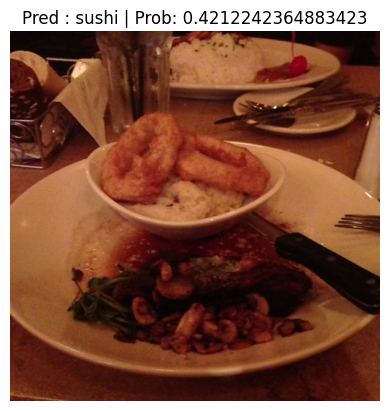

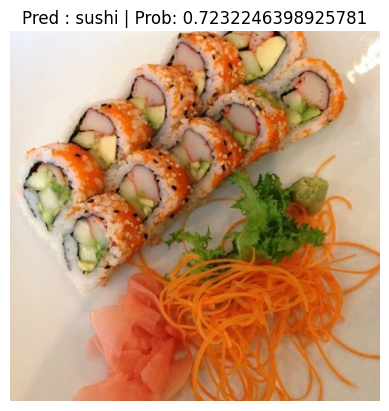

In [ ]:
import random

num_images_to_plot=3
#get a list of all test data'
test_image_path_list = list(Path(test_dir).glob("*/*.jpg"))
test_image_path_sample = random.sample(population= test_image_path_list, k=num_images_to_plot)

for image_path in test_image_path_sample:
  pred_and_plot_image(model=model,
                      image_path=image_path,
                      class_names=class_names,
                      image_size=(224, 224),
                      device=device) # Pass the device to the function

In [ ]:
custom_image_path = data_path / "0.4_pizza_image.jpeg"

if custom_image_path.is_file():
  print(f"{custom_image_path} already exists")
else:
  with open(custom_image_path, "wb") as f:
    request = request.get()
    f.write(request.content)


data/0.4_pizza_image.jpeg already exists


/tmp/ipython-input-2769924827.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


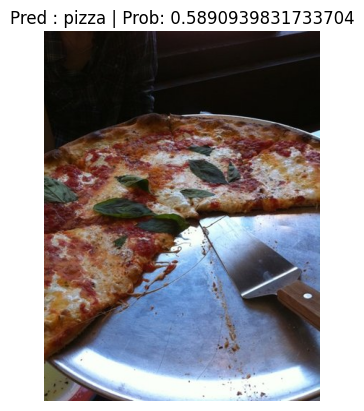

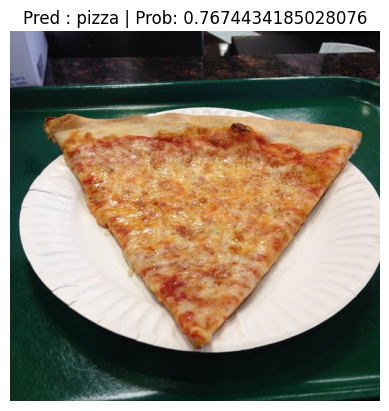

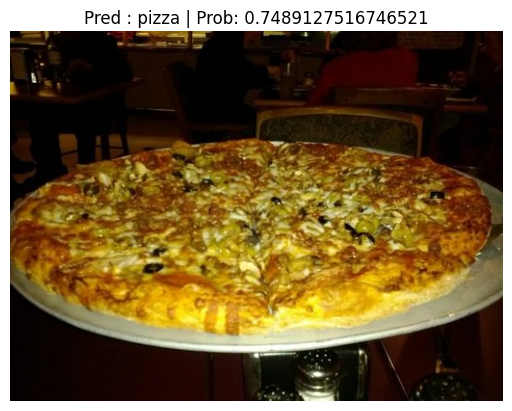

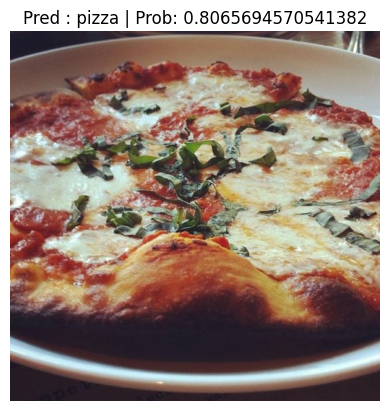

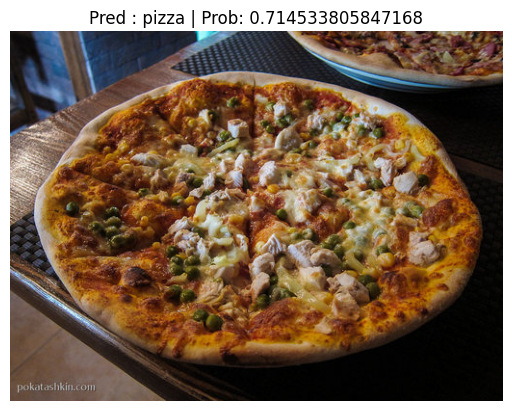

...

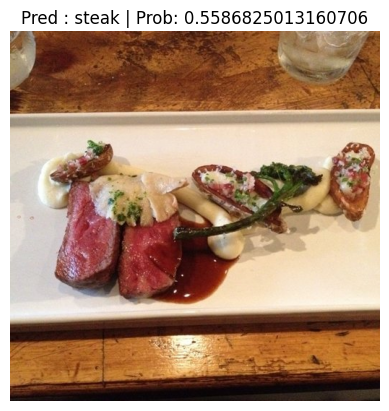

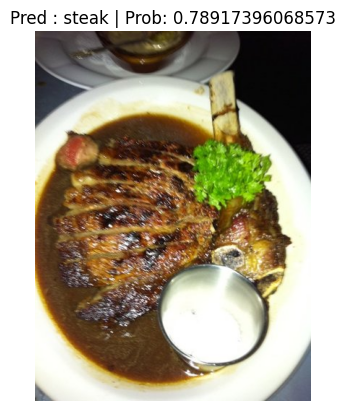

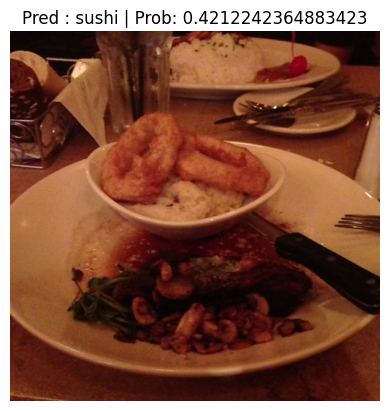

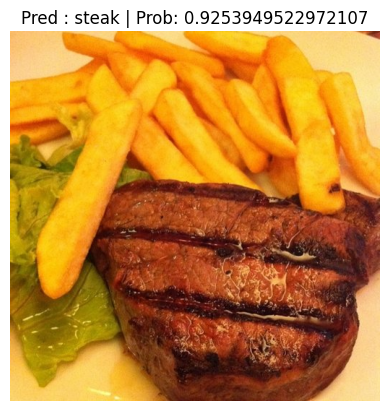

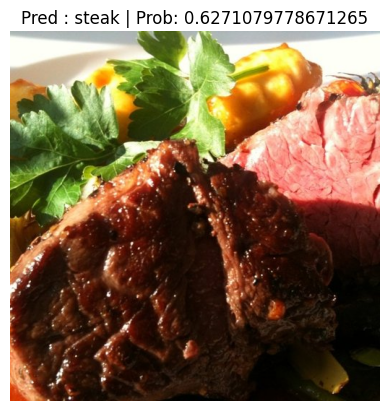

In [ ]:
test_list_image_path = list(Path(test_dir).glob("*/*.jpg"))
test_image_pred = []
for test_image in test_list_image_path:
  pred_class, pred_prob, pred_target = pred_and_plot_image(model=model,
                      image_path=test_image,
                      class_names=class_names,
                      image_size=(224, 224),
                      device=device)

  test_image_pred.append(pred_target)

test_image_tensors = torch.cat(test_image_pred)

In [ ]:
test_image_tensors

tensor([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        2, 2, 2, 1, 2, 2, 1, 2, 1, 2, 2, 2, 2, 1, 0, 2, 2, 2, 2, 2, 2, 2, 1, 2,
        2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        2, 1, 1], device='cuda:0')

In [ ]:
test_labels = []
for X,y in test_dataloader:
  test_labels.append(y)

test_labels = torch.concat(test_labels)
test_labels

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2,
        2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
        2, 2, 2])

In [ ]:
try:
  import torchmetrics, mlxtend
except:
  !pip install -q torchmetrics -U mlxtend
  import torchmetrics, mlxtend

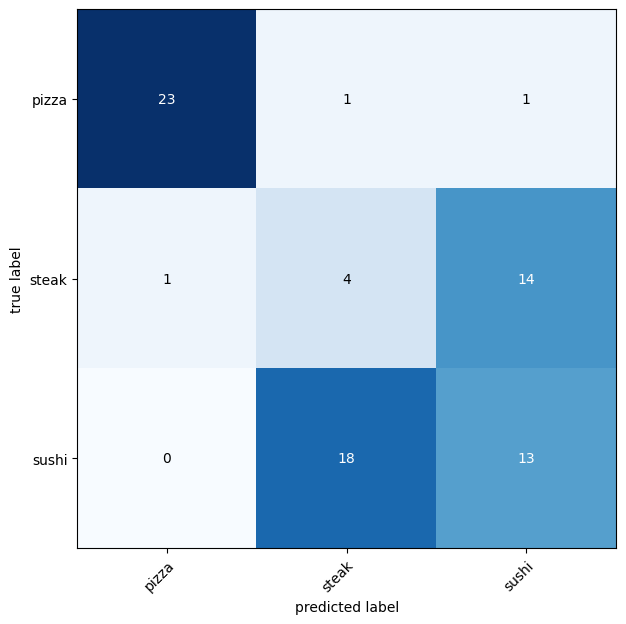

In [ ]:
from torchmetrics import ConfusionMatrix
from mlxtend.plotting import plot_confusion_matrix

confmat = ConfusionMatrix(num_classes=len(class_names), task='multiclass').to(device)
confmat_tensor = confmat(preds=test_image_tensors, target=test_labels.to(device))

fig, ax = plot_confusion_matrix(
    conf_mat = confmat_tensor.cpu().numpy(),
    class_names = class_names,
    figsize=(10,7)
)

In [ ]:
try:
    from torchmetrics import ConfusionMatrix, mlxtend
except:
    !pip install -q torchmetrics -U mlxtend
    from torchmetrics import ConfusionMatrix
    from mlxtend.plotting import plot_confusion_matrix

def prediction_for_test_and_confusion_matrix(model:torch.nn.Module,
                                    test_dataloader,
                                    class_names:List[str],
                                    device=device):
  pred_prob = []
  pred_label = []
  image_truth_labels = []
  wrong_images = []
  wrong_prob = []


  model.eval()
  with torch.inference_mode():
    for images,labels in test_dataloader:
      images, labels = images.to(device), labels.to(device)

      image_truth_labels.append(labels)

      images_logits = model(images)

      images_pred_prob = torch.softmax(images_logits, dim=1)

      images_pred_label = torch.argmax(images_logits, dim=1)

      for i in range(len(labels)):
        if images_pred_label[i] != labels[i]:
          wrong_images.append(images[i])
          wrong_prob.append(images_pred_prob[i].max().item())


      # # Find incorrect predictions
      # incorrect_pred_indices = torch.nonzero(images_pred_label != labels).squeeze()

      # if incorrect_pred_indices.numel() > 0: # Check if there are any incorrect predictions
      #   # If there's only one incorrect prediction, incorrect_pred_indices will be a single value
      #   if incorrect_pred_indices.ndim == 0:
      #       incorrect_pred_indices = incorrect_pred_indices.unsqueeze(0)

      #   wrong_prob.extend(images_pred_prob[incorrect_pred_indices].max(dim=1).values.tolist())
      #   wrong_images.extend(images[incorrect_pred_indices].tolist())


      pred_prob.append(images_pred_prob)

      pred_label.append(images_pred_label)

  # wrong_prob = torch.tensor(wrong_prob)
  # wrong_images = torch.tensor(wrong_images)
  pred_label = torch.concat(pred_label)
  image_truth_labels= torch.concat(image_truth_labels)
  pred_prob = torch.concat(pred_prob)


  #confusion Matrix
  confmat = ConfusionMatrix(num_classes=len(class_names), task= "multiclass").to(device)
  confmat_tensor = confmat(preds=pred_label, target = image_truth_labels)

  fig, ax = plot_confusion_matrix(
      conf_mat= confmat_tensor.cpu().numpy(),
      class_names = class_names,
      figsize=(10,7)
  )

  return pred_label, image_truth_labels, pred_prob, wrong_images, wrong_prob

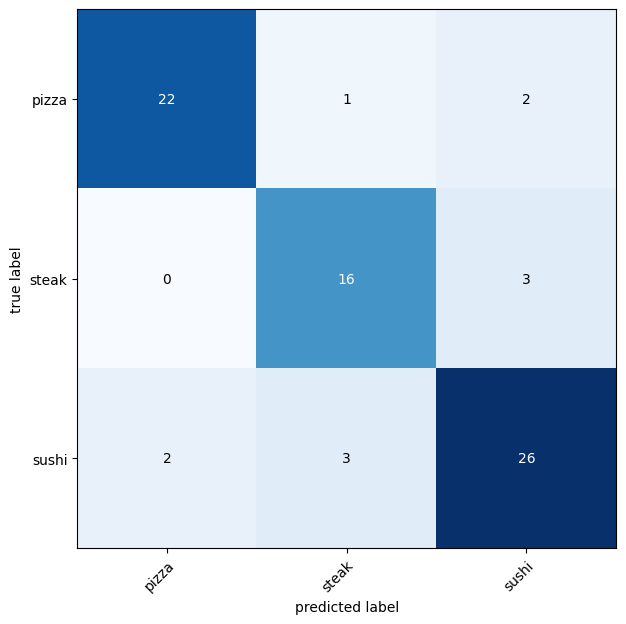

In [ ]:
pred_label, image_truth_labels, pred_prob, wrong_images, wrong_prob = prediction_for_test_and_confusion_matrix(model = model,
                                    test_dataloader = test_dataloader,
                                    class_names = class_names)

In [ ]:
pred_label

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 1, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0,
        0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 2, 1, 1, 1, 1, 2, 2, 2, 2, 2,
        2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 0, 2, 2, 2, 2, 1, 0, 2, 2, 2, 2, 2, 1, 2,
        2, 2, 2], device='cuda:0')

In [ ]:
image_truth_labels

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2,
        2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
        2, 2, 2], device='cuda:0')

In [ ]:
pred_prob

tensor([[0.8220, 0.1278, 0.0502],
        [0.8073, 0.0418, 0.1509],
        [0.8227, 0.1272, 0.0501],
        [0.7449, 0.1694, 0.0857],
        [0.5636, 0.2059, 0.2306],
        [0.6959, 0.1686, 0.1355],
        [0.5164, 0.3664, 0.1172],
        [0.7354, 0.1106, 0.1540],
        [0.8172, 0.0610, 0.1219],
        [0.9337, 0.0195, 0.0468],
        [0.6977, 0.2177, 0.0846],
        [0.7097, 0.1570, 0.1333],
        [0.1514, 0.4198, 0.4288],
        [0.3101, 0.5700, 0.1199],
        [0.6836, 0.1134, 0.2029],
        [0.5970, 0.1482, 0.2548],
        [0.3628, 0.0967, 0.5405],
        [0.8008, 0.1072, 0.0920],
        [0.6934, 0.1532, 0.1534],
        [0.8580, 0.0829, 0.0591],
        [0.7045, 0.1696, 0.1259],
        [0.7719, 0.1718, 0.0564],
        [0.6345, 0.2174, 0.1481],
        [0.8003, 0.0872, 0.1125],
        [0.4622, 0.2163, 0.3215],
        [0.1455, 0.8011, 0.0534],
        [0.0745, 0.9070, 0.0185],
        [0.1538, 0.4490, 0.3972],
        [0.0462, 0.9191, 0.0347],
        [0.292

In [ ]:
wrong_images

[tensor([[[-1.7412, -1.7583, -1.6898,  ...,  0.5364,  0.7077,  0.6734],
          [-1.7412, -1.7412, -1.7754,  ...,  0.6734,  0.7762,  0.7419],
          [-1.8782, -1.8268, -1.8097,  ...,  0.7933,  0.7762,  0.7933],
          ...,
          [ 0.5022,  0.7077,  1.0331,  ..., -1.8953, -1.9295, -2.0152],
          [ 0.4337,  0.7077,  0.9474,  ..., -1.9809, -1.9980, -2.0837],
          [ 0.3823,  0.6563,  0.9132,  ..., -1.9467, -1.8782, -1.9809]],
 
         [[-1.8081, -1.8256, -1.7556,  ...,  0.0301,  0.1877,  0.1527],
          [-1.7906, -1.7731, -1.8081,  ...,  0.2402,  0.3277,  0.2752],
          [-1.8782, -1.8081, -1.7906,  ...,  0.4328,  0.4153,  0.3978],
          ...,
          [-0.6001, -0.3901, -0.0049,  ..., -1.2479, -1.3004, -1.3704],
          [-0.6877, -0.4076, -0.1099,  ..., -1.3704, -1.3880, -1.4930],
          [-0.7577, -0.4776, -0.1625,  ..., -1.3354, -1.3004, -1.4230]],
 
         [[-1.6999, -1.6999, -1.6476,  ..., -0.3230, -0.1661, -0.2358],
          [-1.6650, -1.6824,

In [ ]:
img = next(iter(wrong_images))

In [ ]:
img = img.permute(2,1,0)

In [ ]:
img = img.cpu().numpy()

(np.float64(-0.5), np.float64(223.5), np.float64(223.5), np.float64(-0.5))

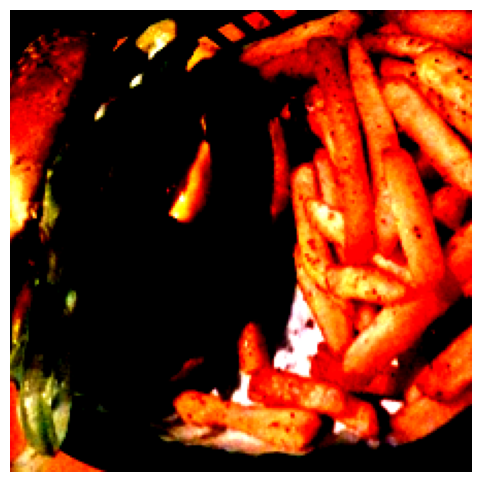

In [ ]:
plt.figure(figsize=(10,6))
plt.imshow(img)
plt.axis(False)

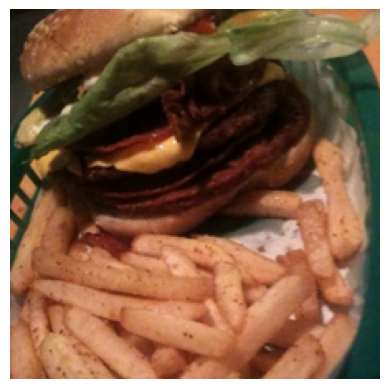

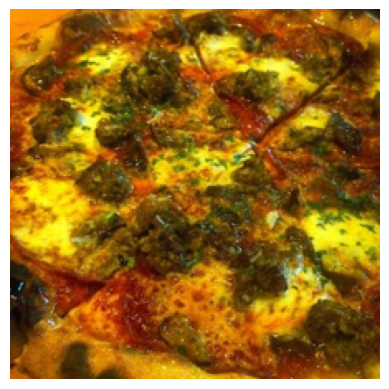

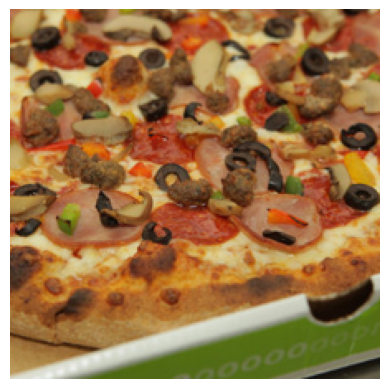

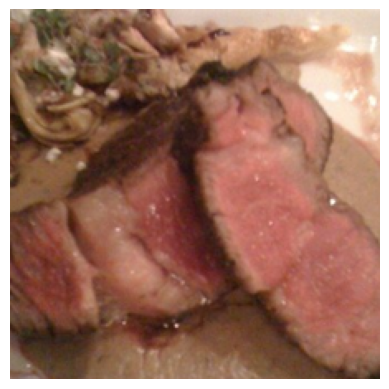

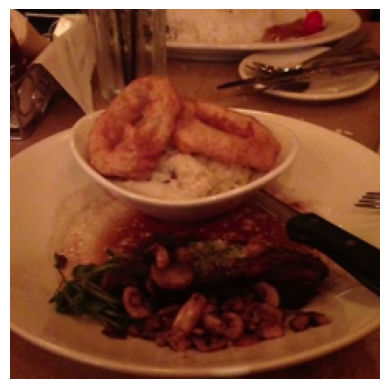

...

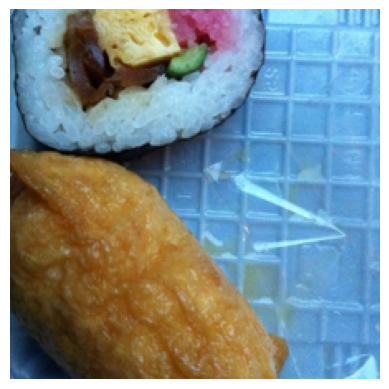

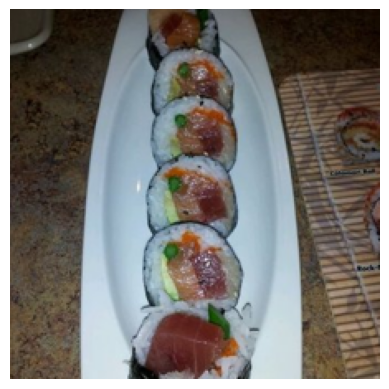

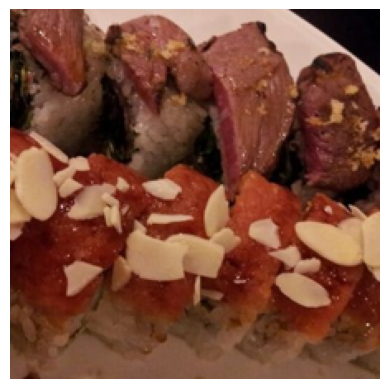

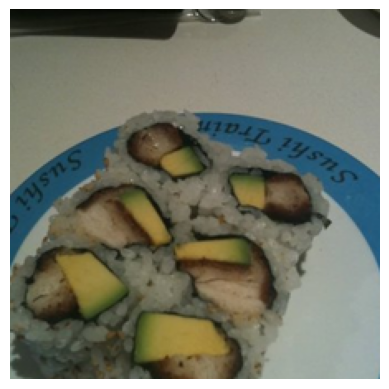

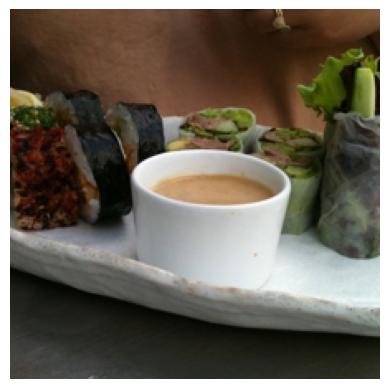

In [ ]:
import torch
import matplotlib.pyplot as plt

mean = torch.tensor([0.485, 0.456, 0.406]).view(3,1,1).to(device)
std  = torch.tensor([0.229, 0.224, 0.225]).view(3,1,1).to(device)

for image_tensor in wrong_images:
    # Unnormalize (keep C,H,W)
    unnormalized_image = image_tensor * std + mean

    # Permute to H,W,C for plotting
    unnormalized_image = unnormalized_image.permute(1,2,0).cpu().numpy()

    # Clip to 0-1 for safe plotting
    # unnormalized_image = unnormalized_image.clip(0,1)

    # Plot
    plt.imshow(unnormalized_image)
    plt.axis('off')
    plt.show()

In [ ]:
for image_tensor in wrong_images:
  print(image_tensor)

tensor([[[-1.7412, -1.7583, -1.6898,  ...,  0.5364,  0.7077,  0.6734],
         [-1.7412, -1.7412, -1.7754,  ...,  0.6734,  0.7762,  0.7419],
         [-1.8782, -1.8268, -1.8097,  ...,  0.7933,  0.7762,  0.7933],
         ...,
         [ 0.5022,  0.7077,  1.0331,  ..., -1.8953, -1.9295, -2.0152],
         [ 0.4337,  0.7077,  0.9474,  ..., -1.9809, -1.9980, -2.0837],
         [ 0.3823,  0.6563,  0.9132,  ..., -1.9467, -1.8782, -1.9809]],

        [[-1.8081, -1.8256, -1.7556,  ...,  0.0301,  0.1877,  0.1527],
         [-1.7906, -1.7731, -1.8081,  ...,  0.2402,  0.3277,  0.2752],
         [-1.8782, -1.8081, -1.7906,  ...,  0.4328,  0.4153,  0.3978],
         ...,
         [-0.6001, -0.3901, -0.0049,  ..., -1.2479, -1.3004, -1.3704],
         [-0.6877, -0.4076, -0.1099,  ..., -1.3704, -1.3880, -1.4930],
         [-0.7577, -0.4776, -0.1625,  ..., -1.3354, -1.3004, -1.4230]],

        [[-1.6999, -1.6999, -1.6476,  ..., -0.3230, -0.1661, -0.2358],
         [-1.6650, -1.6824, -1.7347,  ..., -0

In [ ]:
weights = models.EfficientNet_B2_Weights.DEFAULT

In [ ]:
models = models.efficientnet_b2(weights=weights)

In [ ]:
model.features

Sequential(
  (0): Conv2dNormActivation(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): SiLU(inplace=True)
  )
  (1): Sequential(
    (0): MBConv(
      (block): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
          (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): SiLU(inplace=True)
        )
        (1): SqueezeExcitation(
          (avgpool): AdaptiveAvgPool2d(output_size=1)
          (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
          (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
          (activation): SiLU(inplace=True)
          (scale_activation): Sigmoid()
        )
        (2): Conv2dNormActivation(
          (0): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), 

In [ ]:
summary(
    models,
    input_size=(1,3,224,224),
    col_names=("input_size", "output_size", "num_params", "trainable"),  # choose columns
    col_width=20, )

Layer (type:depth-idx)                                  Input Shape          Output Shape         Param #              Trainable
EfficientNet                                            [1, 3, 224, 224]     [1, 1000]            --                   True
├─Sequential: 1-1                                       [1, 3, 224, 224]     [1, 1408, 7, 7]      --                   True
│    └─Conv2dNormActivation: 2-1                        [1, 3, 224, 224]     [1, 32, 112, 112]    --                   True
│    │    └─Conv2d: 3-1                                 [1, 3, 224, 224]     [1, 32, 112, 112]    864                  True
│    │    └─BatchNorm2d: 3-2                            [1, 32, 112, 112]    [1, 32, 112, 112]    64                   True
│    │    └─SiLU: 3-3                                   [1, 32, 112, 112]    [1, 32, 112, 112]    --                   --
│    └─Sequential: 2-2                                  [1, 32, 112, 112]    [1, 16, 112, 112]    --                   True
│    

In [ ]:
models.classifier

Sequential(
  (0): Dropout(p=0.3, inplace=True)
  (1): Linear(in_features=1408, out_features=1000, bias=True)
)

In [ ]:
for params in models.features.parameters():
  params.requires_grad = False

In [ ]:
summary(
    models,
    input_size=(1,3,224,224),
    col_names=("input_size", "output_size", "num_params", "trainable"),  # choose columns
    col_width=20,
)

Layer (type:depth-idx)                                  Input Shape          Output Shape         Param #              Trainable
EfficientNet                                            [1, 3, 224, 224]     [1, 1000]            --                   Partial
├─Sequential: 1-1                                       [1, 3, 224, 224]     [1, 1408, 7, 7]      --                   False
│    └─Conv2dNormActivation: 2-1                        [1, 3, 224, 224]     [1, 32, 112, 112]    --                   False
│    │    └─Conv2d: 3-1                                 [1, 3, 224, 224]     [1, 32, 112, 112]    (864)                False
│    │    └─BatchNorm2d: 3-2                            [1, 32, 112, 112]    [1, 32, 112, 112]    (64)                 False
│    │    └─SiLU: 3-3                                   [1, 32, 112, 112]    [1, 32, 112, 112]    --                   --
│    └─Sequential: 2-2                                  [1, 32, 112, 112]    [1, 16, 112, 112]    --                   Fal

In [ ]:
models.classifier

Sequential(
  (0): Dropout(p=0.3, inplace=True)
  (1): Linear(in_features=1408, out_features=1000, bias=True)
)

In [ ]:
models.classifier = nn.Sequential(
    nn.Dropout(p=0.3, inplace=True),
    nn.Linear(in_features=1408, out_features=len(class_names), bias=True)
)

In [ ]:
summary(
    models,
    input_size=(1,3,224,224),
    col_names=("input_size", "output_size", "num_params", "trainable"),  # choose columns
    col_width=20,
)

Layer (type:depth-idx)                                  Input Shape          Output Shape         Param #              Trainable
EfficientNet                                            [1, 3, 224, 224]     [1, 3]               --                   Partial
├─Sequential: 1-1                                       [1, 3, 224, 224]     [1, 1408, 7, 7]      --                   False
│    └─Conv2dNormActivation: 2-1                        [1, 3, 224, 224]     [1, 32, 112, 112]    --                   False
│    │    └─Conv2d: 3-1                                 [1, 3, 224, 224]     [1, 32, 112, 112]    (864)                False
│    │    └─BatchNorm2d: 3-2                            [1, 32, 112, 112]    [1, 32, 112, 112]    (64)                 False
│    │    └─SiLU: 3-3                                   [1, 32, 112, 112]    [1, 32, 112, 112]    --                   --
│    └─Sequential: 2-2                                  [1, 32, 112, 112]    [1, 16, 112, 112]    --                   Fal

In [ ]:
models.classifier

Sequential(
  (0): Dropout(p=0.3, inplace=True)
  (1): Linear(in_features=1408, out_features=3, bias=True)
)

In [ ]:
from timeit import default_timer as timer
start_time = timer()

results = engine.train(model=models,
                       train_dataloader=train_dataloader,
                       test_dataloader=test_dataloader,
                       optimizer=optimizer,
                       loss_fn=loss_fn,
                       epochs=5,
                       device=device)

end_time = timer()

print(f"Total training time : {end_time - start_time}")

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 1.1229 | train_acc: 0.3984 | test_loss: 1.1286 | test_acc: 0.2992
Epoch: 2 | train_loss: 1.1035 | train_acc: 0.3789 | test_loss: 1.1541 | test_acc: 0.2491
Epoch: 3 | train_loss: 1.1202 | train_acc: 0.3906 | test_loss: 1.1596 | test_acc: 0.2803
Epoch: 4 | train_loss: 1.1577 | train_acc: 0.2930 | test_loss: 1.1538 | test_acc: 0.2699
Epoch: 5 | train_loss: 1.1589 | train_acc: 0.2461 | test_loss: 1.1577 | test_acc: 0.2898
Total training time : 17.705027732000417
